In [ ]:
import os
import json
import pprint
import re
import pickle
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import warnings
warnings.filterwarnings("ignore")
from wordcloud import WordCloud
import json

In [ ]:
from google.colab import drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def load_json_files_from_directory(directory):
    data = []
    for filename in os.listdir(directory):
        if filename.endswith(".json"):
            file_path = os.path.join(directory, filename)
            with open(file_path, 'r', encoding='utf-8') as file:
                data.append(json.load(file))
    return data

In [ ]:
folder_data = "/content/drive/MyDrive/NLP Indonesia AI/Project - 2/liputan6_data"
dataset_type = "canonical"

train_dir = os.path.join(folder_data, dataset_type, "train")
valid_dir = os.path.join(folder_data, dataset_type, "dev")
test_dir = os.path.join(folder_data, dataset_type, "test")

In [ ]:
train_dir

'/content/drive/MyDrive/NLP Indonesia AI/Project - 2/liputan6_data/canonical/train'

In [ ]:
valid_dir

'/content/drive/MyDrive/NLP Indonesia AI/Project - 2/liputan6_data/canonical/dev'

In [ ]:
test_dir

'/content/drive/MyDrive/NLP Indonesia AI/Project - 2/liputan6_data/canonical/test'

In [ ]:
train_data = load_json_files_from_directory(train_dir)
valid_data = load_json_files_from_directory(valid_dir)
test_data = load_json_files_from_directory(test_dir)

In [ ]:
train_data

[{'id': 91767,
  'url': 'https://www.liputan6.com/news/read/91767/hujan-debu-di-soputan--warga-belum-mengungsi',
  'clean_article': [['Liputan6',
    '.',
    'com',
    ',',
    'Minahasa',
    'Selatan',
    ':',
    'Gunung',
    'Berapi',
    'Soputan',
    'di',
    'Minahasa',
    'Selatan',
    ',',
    'Sulawesi',
    'Utara',
    ',',
    'mulai',
    'bergemuruh',
    'sejak',
    'Sabtu',
    'malam',
    '.'],
   ['Hingga',
    'Senin',
    '(',
    '13/12',
    ')',
    ',',
    'asap',
    'debu',
    'yang',
    'mengepul',
    'dari',
    'Gunung',
    'Soputan',
    'setinggi',
    'satu',
    'kilometer',
    '.'],
   ['Angin',
    'yang',
    'berembus',
    'ke',
    'arah',
    'utara',
    'menyebabkan',
    'sebagian',
    'wilayah',
    'Tombatu',
    ',',
    'Langowan',
    ',',
    'dan',
    'Tondano',
    'ditudungi',
    'hujan',
    'debu',
    '.'],
   ['Kondisi',
    'ini',
    'membuat',
    'pemantau',
    'gunung',
    'menetapkan',
    'status',
   

In [ ]:
valid_data

[{'id': 10735,
  'url': 'https://www.liputan6.com/news/read/10735/kepolisian-mengusut-insiden-penyerbuan-pos-brimob',
  'clean_article': [['Liputan6',
    '.',
    'com',
    ',',
    'Palu',
    ':',
    'Kasus',
    'penyerbuan',
    'pos',
    'penjagaan',
    'pasukan',
    'Brigade',
    'Mobil',
    'di',
    'Kelurahan',
    'Sayo',
    ',',
    'Kecamatan',
    'Poso',
    'Kota',
    ',',
    'Sulawesi',
    'Tengah',
    ',',
    'oleh',
    'sekelompok',
    'massa',
    'masih',
    'gelap',
    '.'],
   ['Sebab',
    ',',
    'Kepolisian',
    'setempat',
    'masih',
    'belum',
    'bisa',
    'memastikan',
    'penyebab',
    'kasus',
    'penyerbuan',
    'berdarah',
    'itu',
    '.'],
   ['Bahkan',
    ',',
    'hingga',
    'saat',
    'ini',
    'Kepolisian',
    'Daerah',
    'Sulteng',
    'masih',
    'terus',
    'mengejar',
    'para',
    'pelaku',
    'penyerbuan',
    'yang',
    'diperkirakan',
    'berjumlah',
    '30',
    'orang',
    '.'],
   ['Peneg

In [ ]:
test_data

[{'id': 25654,
  'url': 'https://www.liputan6.com/news/read/25654/menuntaskan-konflik-poso-di-malino',
  'clean_article': [['Liputan6',
    '.',
    'com',
    ',',
    'Makassar',
    ':',
    'Menteri',
    'Koordinator',
    'Kesejahteraan',
    'Rakyat',
    'Jusuf',
    'Kalla',
    'dan',
    'rombongan',
    'dari',
    'Kantor',
    'Menko',
    'Bidang',
    'Politik',
    'dan',
    'Keamanan',
    ',',
    'Majelis',
    'Ulama',
    'Indonesia',
    'serta',
    'Dewan',
    'Gereja',
    'Indonesia',
    'bertemu',
    'dengan',
    'Gubernur',
    'Sulawesi',
    'Selatan',
    'H',
    '.',
    'Z',
    '.',
    'B',
    'Palaguna',
    'di',
    'Makassar',
    ',',
    'Sulsel',
    ',',
    'Selasa',
    '(',
    '18/12',
    ')',
    '.'],
   ['Mereka',
    'membicarakan',
    'sejumlah',
    'agenda',
    'yang',
    'akan',
    'dibawa',
    'ke',
    'Pertemuan',
    'Malino',
    ',',
    'Sulsel',
    ',',
    'antara',
    'dua',
    'kelompok',
    'agama',
  

## JSON to Dataframe

In [ ]:
train_set = pd.json_normalize(train_data)
valid_set = pd.json_normalize(valid_data)
test_set = pd.json_normalize(test_data)

In [ ]:
train_set

,id,url,clean_article,clean_summary,extractive_summary
0,91767,https://www.liputan6.com/news/read/91767/hujan...,"[[Liputan6, ., com, ,, Minahasa, Selatan, :, G...","[[Petugas, pemantau, gunung, sudah, menetapkan...","[1, 4]"
1,55242,https://www.liputan6.com/news/read/55242/menda...,"[[Liputan6, ., com, ,, Bandung, :, Aliansi, An...","[[Aliansi, Antikorupsi, Jabar, menuding, Deni,...","[1, 3]"
2,206174,https://www.liputan6.com/news/read/206174/terr...,"[[Final, Piala, Liga, atau, Carling, Cup, yang...","[[Chelsea, akhirnya, keluar, sebagai, juara, s...","[0, 2]"
3,274948,https://www.liputan6.com/news/read/274948/iron...,"[[Liputan6, ., com, ,, Buru, :, Di, tengah, mo...","[[Ingar-bingar, pembangunan, tak, sampai, di, ...","[1, 6]"
4,176193,https://www.liputan6.com/news/read/176193/bank...,"[[Liputan6, ., com, ,, Jakarta, :, Bank, Indon...","[[Bank, IFI, dilikuidasi, Bank, Indonesia, mul...","[0, 1]"
...,...,...,...,...,...
10005,104888,https://www.liputan6.com/news/read/104888/janj...,"[[Liputan6, ., com, ,, Jakarta, :, Tias, Suban...","[[Antrean, panjang, tetap, terjadi, di, pom, b...","[3, 5, 9]"
10006,69834,https://www.liputan6.com/news/read/69834/beddu...,"[[Liputan6, ., com, ,, Jakarta, :, Mantan, Kep...","[[Kuasa, hukum, Beddu, Amang, ,, Djoko, Prabow...","[3, 5]"
10007,250820,https://www.liputan6.com/news/read/250820/pres...,"[[Liputan6, ., com, ,, Singapura, :, Presiden,...","[[Presiden, SBY, tiba, di, Singapura, untuk, m...","[0, 6]"
10008,131217,https://www.liputan6.com/news/read/131217/band...,"[[Liputan6, ., com, ,, Jakarta, :, Setelah, be...","[[Kendati, kabut, asap, muncul, kembali, ,, Ba...","[1, 2]"


In [ ]:
valid_set

,id,url,clean_article,clean_summary,extractive_summary
0,10735,https://www.liputan6.com/news/read/10735/kepol...,"[[Liputan6, ., com, ,, Palu, :, Kasus, penyerb...","[[Polda, Sulteng, masih, belum, bisa, memastik...","[1, 6]"
1,10899,https://www.liputan6.com/news/read/10899/digel...,"[[Liputan6, ., com, ,, Jakarta, :, Konflik, be...","[[Konflik, berkepanjangan, di, Aceh, menyebabk...","[0, 3, 2]"
2,7515,https://www.liputan6.com/news/read/7515/imf-me...,"[[Liputan6, ., com, ,, Jakarta, :, Dana, Monet...","[[IMF, mendesak, pemerintah, Indonesia, untuk,...","[0, 5]"
3,10134,https://www.liputan6.com/news/read/10134/nasib...,"[[Liputan6, ., com, ,, Lampung, :, Ribuan, peg...","[[Ribuan, PNS, bekas, kanwil, instansi, yang, ...","[0, 7]"
4,8126,https://www.liputan6.com/news/read/8126/kapolr...,"[[Liputan6, ., com, ,, Jakarta, :, Polri, belu...","[[Polri, belum, mau, menyelidiki, kasus, pengg...","[0, 1]"
...,...,...,...,...,...
10977,1139,https://www.liputan6.com/news/read/1139/status...,"[[Liputan6, ., com, ,, Jakarta, :, Status, Gub...","[[Status, Syahril, dialihkan, menjadi, tahanan...","[2, 7]"
10978,6367,https://www.liputan6.com/news/read/6367/sejara...,"[[Liputan6, ., com, ,, Jakarta, :, Pelaku, sej...","[[Memperdebatkan, sosok, yang, memberikan, kom...","[0, 1]"
10979,3086,https://www.liputan6.com/news/read/3086/wanita...,"[[Liputan6, ., com, ,, Pekanbaru, :, Polisi, k...","[[Seorang, wanita, muda, yang, tengah, hamil, ...","[1, 6]"
10980,470,https://www.liputan6.com/news/read/470/mengena...,"[[Liputan6, ., Com, ,, Jakarta, :, Usai, mempe...","[[Massa, Front, Hizbullah, turun, ke, jalan, ....","[12, 13]"


In [ ]:
test_set

,id,url,clean_article,clean_summary,extractive_summary
0,25654,https://www.liputan6.com/news/read/25654/menun...,"[[Liputan6, ., com, ,, Makassar, :, Menteri, K...","[[Perlucutan, senjata, dan, rehabilitasi, pasc...","[2, 14]"
1,25758,https://www.liputan6.com/news/read/25758/dekla...,"[[Liputan6, ., com, ,, Malino, :, Sesuai, hara...","[[Dua, kubu, agama, yang, bertikai, di, Poso, ...","[0, 8]"
2,22724,https://www.liputan6.com/news/read/22724/akbar...,"[[Liputan6, ., com, ,, Jakarta, :, Wajah, Akba...","[[Dana, nonbujeter, Bulog, untuk, rakyat, misk...","[6, 55, 26]"
3,24391,https://www.liputan6.com/news/read/24391/kejag...,"[[Liputan6, ., com, ,, Jakarta, :, Ketua, Yaya...","[[Kejaksaan, Agung, kembali, memeriksa, Ketua,...","[0, 7, 8]"
4,24892,https://www.liputan6.com/news/read/24892/ratus...,"[[Liputan6, ., com, ,, Jakarta, :, Kesemrawuta...","[[PT, Pelni, mengaku, kewalahan, melayani, sel...","[1, 2]"
...,...,...,...,...,...
10967,14790,https://www.liputan6.com/news/read/14790/tim-p...,"[[Liputan6, ., com, ,, Jakarta, :, Menteri, Ko...","[[Menko, Polsoskam, ,, Menteri, Pertahanan, ,,...","[1, 3]"
10968,13220,https://www.liputan6.com/news/read/13220/strat...,"[[Liputan6, ., com, ,, Jakarta, :, Permintaan,...","[[Terapi, hydro, pada, usus, besar, dan, terap...","[2, 7]"
10969,15618,https://www.liputan6.com/news/read/15618/pkb-t...,"[[Liputan6, ., com, ,, Jakarta, :, Partai, Keb...","[[PKB, tidak, akan, ikut-ikutan, merekomendasi...","[0, 8]"
10970,15074,https://www.liputan6.com/news/read/15074/jalur...,"[[Liputan6, ., com, ,, Jakarta, :, Jalur, kere...","[[Rel, kereta, api, yang, melintasi, Sungai, C...","[1, 5]"


In [ ]:
def normalize_text(tokenized_text):
    normalized_text = ""
    for sentence in tokenized_text:
        for word in sentence:
            if word in [".", ",", ":", ";", "!", "?", ")", "]"]:
                normalized_text = normalized_text.rstrip() + word + " "
            elif word in ["(", "["]:
                normalized_text += word
            else:
                normalized_text += word + " "
    return normalized_text.strip()


train_set['combined_clean_article'] = train_set['clean_article'].apply(normalize_text)
train_set['combined_clean_summary'] = train_set['clean_summary'].apply(normalize_text)

In [ ]:
train_set

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary
0,91767,https://www.liputan6.com/news/read/91767/hujan...,"[[Liputan6, ., com, ,, Minahasa, Selatan, :, G...","[[Petugas, pemantau, gunung, sudah, menetapkan...","[1, 4]","Liputan6. com, Minahasa Selatan: Gunung Berapi...",Petugas pemantau gunung sudah menetapkan statu...
1,55242,https://www.liputan6.com/news/read/55242/menda...,"[[Liputan6, ., com, ,, Bandung, :, Aliansi, An...","[[Aliansi, Antikorupsi, Jabar, menuding, Deni,...","[1, 3]","Liputan6. com, Bandung: Aliansi Antikorupsi Ja...",Aliansi Antikorupsi Jabar menuding Deni Setiaw...
2,206174,https://www.liputan6.com/news/read/206174/terr...,"[[Final, Piala, Liga, atau, Carling, Cup, yang...","[[Chelsea, akhirnya, keluar, sebagai, juara, s...","[0, 2]",Final Piala Liga atau Carling Cup yang berlang...,Chelsea akhirnya keluar sebagai juara setelah ...
3,274948,https://www.liputan6.com/news/read/274948/iron...,"[[Liputan6, ., com, ,, Buru, :, Di, tengah, mo...","[[Ingar-bingar, pembangunan, tak, sampai, di, ...","[1, 6]","Liputan6. com, Buru: Di tengah modernisasi dan...",Ingar-bingar pembangunan tak sampai di Pulau B...
4,176193,https://www.liputan6.com/news/read/176193/bank...,"[[Liputan6, ., com, ,, Jakarta, :, Bank, Indon...","[[Bank, IFI, dilikuidasi, Bank, Indonesia, mul...","[0, 1]","Liputan6. com, Jakarta: Bank Indonesia melikui...",Bank IFI dilikuidasi Bank Indonesia mulai hari...
...,...,...,...,...,...,...,...
10005,104888,https://www.liputan6.com/news/read/104888/janj...,"[[Liputan6, ., com, ,, Jakarta, :, Tias, Suban...","[[Antrean, panjang, tetap, terjadi, di, pom, b...","[3, 5, 9]","Liputan6. com, Jakarta: Tias Suban kecewa. War...",Antrean panjang tetap terjadi di pom bensin di...
10006,69834,https://www.liputan6.com/news/read/69834/beddu...,"[[Liputan6, ., com, ,, Jakarta, :, Mantan, Kep...","[[Kuasa, hukum, Beddu, Amang, ,, Djoko, Prabow...","[3, 5]","Liputan6. com, Jakarta: Mantan Kepala Badan Ur...","Kuasa hukum Beddu Amang, Djoko Prabowo mengata..."
10007,250820,https://www.liputan6.com/news/read/250820/pres...,"[[Liputan6, ., com, ,, Singapura, :, Presiden,...","[[Presiden, SBY, tiba, di, Singapura, untuk, m...","[0, 6]","Liputan6. com, Singapura: Presiden Susilo Bamb...",Presiden SBY tiba di Singapura untuk menjalani...
10008,131217,https://www.liputan6.com/news/read/131217/band...,"[[Liputan6, ., com, ,, Jakarta, :, Setelah, be...","[[Kendati, kabut, asap, muncul, kembali, ,, Ba...","[1, 2]","Liputan6. com, Jakarta: Setelah beberapa hari ...","Kendati kabut asap muncul kembali, Bandara Sup..."


In [ ]:
valid_set['combined_clean_article'] = valid_set['clean_article'].apply(normalize_text)
valid_set['combined_clean_summary'] = valid_set['clean_summary'].apply(normalize_text)

In [ ]:
valid_set

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary
0,10735,https://www.liputan6.com/news/read/10735/kepol...,"[[Liputan6, ., com, ,, Palu, :, Kasus, penyerb...","[[Polda, Sulteng, masih, belum, bisa, memastik...","[1, 6]","Liputan6. com, Palu: Kasus penyerbuan pos penj...",Polda Sulteng masih belum bisa memastikan peny...
1,10899,https://www.liputan6.com/news/read/10899/digel...,"[[Liputan6, ., com, ,, Jakarta, :, Konflik, be...","[[Konflik, berkepanjangan, di, Aceh, menyebabk...","[0, 3, 2]","Liputan6. com, Jakarta: Konflik berkepanjangan...",Konflik berkepanjangan di Aceh menyebabkan ind...
2,7515,https://www.liputan6.com/news/read/7515/imf-me...,"[[Liputan6, ., com, ,, Jakarta, :, Dana, Monet...","[[IMF, mendesak, pemerintah, Indonesia, untuk,...","[0, 5]","Liputan6. com, Jakarta: Dana Moneter Internasi...",IMF mendesak pemerintah Indonesia untuk melara...
3,10134,https://www.liputan6.com/news/read/10134/nasib...,"[[Liputan6, ., com, ,, Lampung, :, Ribuan, peg...","[[Ribuan, PNS, bekas, kanwil, instansi, yang, ...","[0, 7]","Liputan6. com, Lampung: Ribuan pegawai negeri ...",Ribuan PNS bekas kanwil instansi yang dibubark...
4,8126,https://www.liputan6.com/news/read/8126/kapolr...,"[[Liputan6, ., com, ,, Jakarta, :, Polri, belu...","[[Polri, belum, mau, menyelidiki, kasus, pengg...","[0, 1]","Liputan6. com, Jakarta: Polri belum berencana ...",Polri belum mau menyelidiki kasus penggunaan d...
...,...,...,...,...,...,...,...
10977,1139,https://www.liputan6.com/news/read/1139/status...,"[[Liputan6, ., com, ,, Jakarta, :, Status, Gub...","[[Status, Syahril, dialihkan, menjadi, tahanan...","[2, 7]","Liputan6. com, Jakarta: Status Gubernur Bank I...",Status Syahril dialihkan menjadi tahanan rumah...
10978,6367,https://www.liputan6.com/news/read/6367/sejara...,"[[Liputan6, ., com, ,, Jakarta, :, Pelaku, sej...","[[Memperdebatkan, sosok, yang, memberikan, kom...","[0, 1]","Liputan6. com, Jakarta: Pelaku sejarah Seranga...",Memperdebatkan sosok yang memberikan komando u...
10979,3086,https://www.liputan6.com/news/read/3086/wanita...,"[[Liputan6, ., com, ,, Pekanbaru, :, Polisi, k...","[[Seorang, wanita, muda, yang, tengah, hamil, ...","[1, 6]","Liputan6. com, Pekanbaru: Polisi kembali mengu...",Seorang wanita muda yang tengah hamil lima bul...
10980,470,https://www.liputan6.com/news/read/470/mengena...,"[[Liputan6, ., Com, ,, Jakarta, :, Usai, mempe...","[[Massa, Front, Hizbullah, turun, ke, jalan, ....","[12, 13]","Liputan6. Com, Jakarta: Usai memperingati 40 h...",Massa Front Hizbullah turun ke jalan. Mereka m...


In [ ]:
test_set['combined_clean_article'] = test_set['clean_article'].apply(normalize_text)
test_set['combined_clean_summary'] = test_set['clean_summary'].apply(normalize_text)

In [ ]:
test_set

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary
0,25654,https://www.liputan6.com/news/read/25654/menun...,"[[Liputan6, ., com, ,, Makassar, :, Menteri, K...","[[Perlucutan, senjata, dan, rehabilitasi, pasc...","[2, 14]","Liputan6. com, Makassar: Menteri Koordinator K...",Perlucutan senjata dan rehabilitasi pascakonfl...
1,25758,https://www.liputan6.com/news/read/25758/dekla...,"[[Liputan6, ., com, ,, Malino, :, Sesuai, hara...","[[Dua, kubu, agama, yang, bertikai, di, Poso, ...","[0, 8]","Liputan6. com, Malino: Sesuai harapan semua ka...","Dua kubu agama yang bertikai di Poso, Sulteng,..."
2,22724,https://www.liputan6.com/news/read/22724/akbar...,"[[Liputan6, ., com, ,, Jakarta, :, Wajah, Akba...","[[Dana, nonbujeter, Bulog, untuk, rakyat, misk...","[6, 55, 26]","Liputan6. com, Jakarta: Wajah Akbar Tandjung b...",Dana nonbujeter Bulog untuk rakyat miskin didu...
3,24391,https://www.liputan6.com/news/read/24391/kejag...,"[[Liputan6, ., com, ,, Jakarta, :, Ketua, Yaya...","[[Kejaksaan, Agung, kembali, memeriksa, Ketua,...","[0, 7, 8]","Liputan6. com, Jakarta: Ketua Yayasan Raudatul...",Kejaksaan Agung kembali memeriksa Ketua Yayasa...
4,24892,https://www.liputan6.com/news/read/24892/ratus...,"[[Liputan6, ., com, ,, Jakarta, :, Kesemrawuta...","[[PT, Pelni, mengaku, kewalahan, melayani, sel...","[1, 2]","Liputan6. com, Jakarta: Kesemrawutan penangana...",PT Pelni mengaku kewalahan melayani seluruh ca...
...,...,...,...,...,...,...,...
10967,14790,https://www.liputan6.com/news/read/14790/tim-p...,"[[Liputan6, ., com, ,, Jakarta, :, Menteri, Ko...","[[Menko, Polsoskam, ,, Menteri, Pertahanan, ,,...","[1, 3]","Liputan6. com, Jakarta: Menteri Koordinator Po...","Menko Polsoskam, Menteri Pertahanan, dan Menda..."
10968,13220,https://www.liputan6.com/news/read/13220/strat...,"[[Liputan6, ., com, ,, Jakarta, :, Permintaan,...","[[Terapi, hydro, pada, usus, besar, dan, terap...","[2, 7]","Liputan6. com, Jakarta: Permintaan manusia sup...",Terapi hydro pada usus besar dan terapi ozon p...
10969,15618,https://www.liputan6.com/news/read/15618/pkb-t...,"[[Liputan6, ., com, ,, Jakarta, :, Partai, Keb...","[[PKB, tidak, akan, ikut-ikutan, merekomendasi...","[0, 8]","Liputan6. com, Jakarta: Partai Kebangkitan Ban...",PKB tidak akan ikut-ikutan merekomendasikan pe...
10970,15074,https://www.liputan6.com/news/read/15074/jalur...,"[[Liputan6, ., com, ,, Jakarta, :, Jalur, kere...","[[Rel, kereta, api, yang, melintasi, Sungai, C...","[1, 5]","Liputan6. com, Jakarta: Jalur kereta api jurus...",Rel kereta api yang melintasi Sungai Cola Desa...


## Exploratory Data Analysis

In [ ]:
import os
import json
import pprint
import re
import pickle
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import warnings
warnings.filterwarnings("ignore")
from wordcloud import WordCloud
import json

In [ ]:
# Pola regex untuk punctuation
punctuation_pattern = r'[^\w\s@]'

# cek tweet apakah ada punctuation
rows_with_punctuation = train_set[train_set['combined_clean_article'].str.contains(punctuation_pattern, regex=True)]

# ekstraksi punctuation
def extract_punctuation(teks):
    punctuations = re.findall(punctuation_pattern, teks)
    return ', '.join(punctuations) if punctuations else None

# add kolom 'punctuations' ke DataFrame
rows_with_punctuation['punctuations'] = rows_with_punctuation['combined_clean_article'].apply(extract_punctuation)

rows_with_punctuation

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,punctuations
0,91767,https://www.liputan6.com/news/read/91767/hujan...,"[[Liputan6, ., com, ,, Minahasa, Selatan, :, G...","[[Petugas, pemantau, gunung, sudah, menetapkan...","[1, 4]","Liputan6. com, Minahasa Selatan: Gunung Berapi...",Petugas pemantau gunung sudah menetapkan statu...,"., ,, :, ,, ,, ., (, /, ), ,, ., ,, ,, ., ., ,..."
1,55242,https://www.liputan6.com/news/read/55242/menda...,"[[Liputan6, ., com, ,, Bandung, :, Aliansi, An...","[[Aliansi, Antikorupsi, Jabar, menuding, Deni,...","[1, 3]","Liputan6. com, Bandung: Aliansi Antikorupsi Ja...",Aliansi Antikorupsi Jabar menuding Deni Setiaw...,"., ,, :, ., ,, ., ., ,, ,, -, ., ,, ,, ., ,, ...."
2,206174,https://www.liputan6.com/news/read/206174/terr...,"[[Final, Piala, Liga, atau, Carling, Cup, yang...","[[Chelsea, akhirnya, keluar, sebagai, juara, s...","[0, 2]",Final Piala Liga atau Carling Cup yang berlang...,Chelsea akhirnya keluar sebagai juara setelah ...,",, (, /, ), ., ,, ., ,, ,, ., ,, ., ,, ., ., ,..."
3,274948,https://www.liputan6.com/news/read/274948/iron...,"[[Liputan6, ., com, ,, Buru, :, Di, tengah, mo...","[[Ingar-bingar, pembangunan, tak, sampai, di, ...","[1, 6]","Liputan6. com, Buru: Di tengah modernisasi dan...",Ingar-bingar pembangunan tak sampai di Pulau B...,"., ,, :, -, ,, ., ,, ,, ., ,, ., ., ., ,, -, ...."
4,176193,https://www.liputan6.com/news/read/176193/bank...,"[[Liputan6, ., com, ,, Jakarta, :, Bank, Indon...","[[Bank, IFI, dilikuidasi, Bank, Indonesia, mul...","[0, 1]","Liputan6. com, Jakarta: Bank Indonesia melikui...",Bank IFI dilikuidasi Bank Indonesia mulai hari...,"., ,, :, (, /, ), ., ., ., ., (, ), ., ,, ,, ...."
...,...,...,...,...,...,...,...,...
10005,104888,https://www.liputan6.com/news/read/104888/janj...,"[[Liputan6, ., com, ,, Jakarta, :, Tias, Suban...","[[Antrean, panjang, tetap, terjadi, di, pom, b...","[3, 5, 9]","Liputan6. com, Jakarta: Tias Suban kecewa. War...",Antrean panjang tetap terjadi di pom bensin di...,"., ,, :, ., ,, ,, ., ,, ,, (, /, ), ., ,, ., ""..."
10006,69834,https://www.liputan6.com/news/read/69834/beddu...,"[[Liputan6, ., com, ,, Jakarta, :, Mantan, Kep...","[[Kuasa, hukum, Beddu, Amang, ,, Djoko, Prabow...","[3, 5]","Liputan6. com, Jakarta: Mantan Kepala Badan Ur...","Kuasa hukum Beddu Amang, Djoko Prabowo mengata...","., ,, :, ,, (, /, ), ,, ., ,, ., ., ,, ., ,, ...."
10007,250820,https://www.liputan6.com/news/read/250820/pres...,"[[Liputan6, ., com, ,, Singapura, :, Presiden,...","[[Presiden, SBY, tiba, di, Singapura, untuk, m...","[0, 6]","Liputan6. com, Singapura: Presiden Susilo Bamb...",Presiden SBY tiba di Singapura untuk menjalani...,"., ,, :, ,, (, /, ), ,, (, ), ., ,, ,, ., ,, ...."
10008,131217,https://www.liputan6.com/news/read/131217/band...,"[[Liputan6, ., com, ,, Jakarta, :, Setelah, be...","[[Kendati, kabut, asap, muncul, kembali, ,, Ba...","[1, 2]","Liputan6. com, Jakarta: Setelah beberapa hari ...","Kendati kabut asap muncul kembali, Bandara Sup...","., ,, :, ,, ., ., [, :, ], ., ,, ,, ., ., ., ,..."


In [ ]:
# Pola regex untuk non-alfanumerik
non_alnum_pattern = r'\W+'

# cek non alfanumerik
rows_with_non_alnum = train_set[train_set['combined_clean_article'].str.contains(non_alnum_pattern, regex=True)]

# ekstraksi non alfanumeric
def extract_non_alnum(teks):
    non_alnums = re.findall(non_alnum_pattern, teks)
    return ', '.join(non_alnums) if non_alnums else None

# add kolom 'non_alphanumeric' ke DataFrame
rows_with_non_alnum['non_alphanumeric'] = rows_with_non_alnum['combined_clean_article'].apply(extract_non_alnum)

In [ ]:
rows_with_non_alnum

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,non_alphanumeric
0,91767,https://www.liputan6.com/news/read/91767/hujan...,"[[Liputan6, ., com, ,, Minahasa, Selatan, :, G...","[[Petugas, pemantau, gunung, sudah, menetapkan...","[1, 4]","Liputan6. com, Minahasa Selatan: Gunung Berapi...",Petugas pemantau gunung sudah menetapkan statu...,". , , , , : , , , , , , , , , , , , ,..."
1,55242,https://www.liputan6.com/news/read/55242/menda...,"[[Liputan6, ., com, ,, Bandung, :, Aliansi, An...","[[Aliansi, Antikorupsi, Jabar, menuding, Deni,...","[1, 3]","Liputan6. com, Bandung: Aliansi Antikorupsi Ja...",Aliansi Antikorupsi Jabar menuding Deni Setiaw...,". , , , : , , , , , , , , , , , , ..."
2,206174,https://www.liputan6.com/news/read/206174/terr...,"[[Final, Piala, Liga, atau, Carling, Cup, yang...","[[Chelsea, akhirnya, keluar, sebagai, juara, s...","[0, 2]",Final Piala Liga atau Carling Cup yang berlang...,Chelsea akhirnya keluar sebagai juara setelah ...,", , , , , , , , , , , , (, /, ) , ..."
3,274948,https://www.liputan6.com/news/read/274948/iron...,"[[Liputan6, ., com, ,, Buru, :, Di, tengah, mo...","[[Ingar-bingar, pembangunan, tak, sampai, di, ...","[1, 6]","Liputan6. com, Buru: Di tengah modernisasi dan...",Ingar-bingar pembangunan tak sampai di Pulau B...,". , , , : , , , , , -, , , , , , , , ..."
4,176193,https://www.liputan6.com/news/read/176193/bank...,"[[Liputan6, ., com, ,, Jakarta, :, Bank, Indon...","[[Bank, IFI, dilikuidasi, Bank, Indonesia, mul...","[0, 1]","Liputan6. com, Jakarta: Bank Indonesia melikui...",Bank IFI dilikuidasi Bank Indonesia mulai hari...,". , , , : , , , , , , , (, /, ). , , ..."
...,...,...,...,...,...,...,...,...
10005,104888,https://www.liputan6.com/news/read/104888/janj...,"[[Liputan6, ., com, ,, Jakarta, :, Tias, Suban...","[[Antrean, panjang, tetap, terjadi, di, pom, b...","[3, 5, 9]","Liputan6. com, Jakarta: Tias Suban kecewa. War...",Antrean panjang tetap terjadi di pom bensin di...,". , , , : , , , . , , , , , , , , , . , ..."
10006,69834,https://www.liputan6.com/news/read/69834/beddu...,"[[Liputan6, ., com, ,, Jakarta, :, Mantan, Kep...","[[Kuasa, hukum, Beddu, Amang, ,, Djoko, Prabow...","[3, 5]","Liputan6. com, Jakarta: Mantan Kepala Badan Ur...","Kuasa hukum Beddu Amang, Djoko Prabowo mengata...",". , , , : , , , , , , , , , , , , ..."
10007,250820,https://www.liputan6.com/news/read/250820/pres...,"[[Liputan6, ., com, ,, Singapura, :, Presiden,...","[[Presiden, SBY, tiba, di, Singapura, untuk, m...","[0, 6]","Liputan6. com, Singapura: Presiden Susilo Bamb...",Presiden SBY tiba di Singapura untuk menjalani...,". , , , : , , , , , , (, /, ) , , , , , ..."
10008,131217,https://www.liputan6.com/news/read/131217/band...,"[[Liputan6, ., com, ,, Jakarta, :, Setelah, be...","[[Kendati, kabut, asap, muncul, kembali, ,, Ba...","[1, 2]","Liputan6. com, Jakarta: Setelah beberapa hari ...","Kendati kabut asap muncul kembali, Bandara Sup...",". , , , : , , , , , , , , , , , , ..."


In [ ]:
# Pola regex untuk special characters
special_char_pattern = r'[^a-zA-Z0-9\s]'

# cek special characters
rows_with_special_char = train_set[train_set['combined_clean_article'].str.contains(special_char_pattern, regex=True)]

# ekstrak special character
def extract_special_char(teks):
    special_chars = re.findall(special_char_pattern, teks)
    return ', '.join(special_chars) if special_chars else None

# add kolom 'special_characters' ke DataFrame
rows_with_special_char['special_characters'] = rows_with_special_char['combined_clean_article'].apply(extract_special_char)

# sanity check
rows_with_special_char

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,special_characters
0,91767,https://www.liputan6.com/news/read/91767/hujan...,"[[Liputan6, ., com, ,, Minahasa, Selatan, :, G...","[[Petugas, pemantau, gunung, sudah, menetapkan...","[1, 4]","Liputan6. com, Minahasa Selatan: Gunung Berapi...",Petugas pemantau gunung sudah menetapkan statu...,"., ,, :, ,, ,, ., (, /, ), ,, ., ,, ,, ., ., ,..."
1,55242,https://www.liputan6.com/news/read/55242/menda...,"[[Liputan6, ., com, ,, Bandung, :, Aliansi, An...","[[Aliansi, Antikorupsi, Jabar, menuding, Deni,...","[1, 3]","Liputan6. com, Bandung: Aliansi Antikorupsi Ja...",Aliansi Antikorupsi Jabar menuding Deni Setiaw...,"., ,, :, ., ,, ., ., ,, ,, -, ., ,, ,, ., ,, ...."
2,206174,https://www.liputan6.com/news/read/206174/terr...,"[[Final, Piala, Liga, atau, Carling, Cup, yang...","[[Chelsea, akhirnya, keluar, sebagai, juara, s...","[0, 2]",Final Piala Liga atau Carling Cup yang berlang...,Chelsea akhirnya keluar sebagai juara setelah ...,",, (, /, ), ., ,, ., ,, ,, ., ,, ., ,, ., ., ,..."
3,274948,https://www.liputan6.com/news/read/274948/iron...,"[[Liputan6, ., com, ,, Buru, :, Di, tengah, mo...","[[Ingar-bingar, pembangunan, tak, sampai, di, ...","[1, 6]","Liputan6. com, Buru: Di tengah modernisasi dan...",Ingar-bingar pembangunan tak sampai di Pulau B...,"., ,, :, -, ,, ., ,, ,, ., ,, ., ., ., ,, -, ...."
4,176193,https://www.liputan6.com/news/read/176193/bank...,"[[Liputan6, ., com, ,, Jakarta, :, Bank, Indon...","[[Bank, IFI, dilikuidasi, Bank, Indonesia, mul...","[0, 1]","Liputan6. com, Jakarta: Bank Indonesia melikui...",Bank IFI dilikuidasi Bank Indonesia mulai hari...,"., ,, :, (, /, ), ., ., ., ., (, ), ., ,, ,, ...."
...,...,...,...,...,...,...,...,...
10005,104888,https://www.liputan6.com/news/read/104888/janj...,"[[Liputan6, ., com, ,, Jakarta, :, Tias, Suban...","[[Antrean, panjang, tetap, terjadi, di, pom, b...","[3, 5, 9]","Liputan6. com, Jakarta: Tias Suban kecewa. War...",Antrean panjang tetap terjadi di pom bensin di...,"., ,, :, ., ,, ,, ., ,, ,, (, /, ), ., ,, ., ""..."
10006,69834,https://www.liputan6.com/news/read/69834/beddu...,"[[Liputan6, ., com, ,, Jakarta, :, Mantan, Kep...","[[Kuasa, hukum, Beddu, Amang, ,, Djoko, Prabow...","[3, 5]","Liputan6. com, Jakarta: Mantan Kepala Badan Ur...","Kuasa hukum Beddu Amang, Djoko Prabowo mengata...","., ,, :, ,, (, /, ), ,, ., ,, ., ., ,, ., ,, ...."
10007,250820,https://www.liputan6.com/news/read/250820/pres...,"[[Liputan6, ., com, ,, Singapura, :, Presiden,...","[[Presiden, SBY, tiba, di, Singapura, untuk, m...","[0, 6]","Liputan6. com, Singapura: Presiden Susilo Bamb...",Presiden SBY tiba di Singapura untuk menjalani...,"., ,, :, ,, (, /, ), ,, (, ), ., ,, ,, ., ,, ...."
10008,131217,https://www.liputan6.com/news/read/131217/band...,"[[Liputan6, ., com, ,, Jakarta, :, Setelah, be...","[[Kendati, kabut, asap, muncul, kembali, ,, Ba...","[1, 2]","Liputan6. com, Jakarta: Setelah beberapa hari ...","Kendati kabut asap muncul kembali, Bandara Sup...","., ,, :, ,, ., ., [, :, ], ., ,, ,, ., ., ., ,..."


In [ ]:
# Pola regex untuk spasi ganda
double_space_pattern = r'\s\s+'

# cek double space
rows_with_double_space = train_set[train_set['combined_clean_article'].str.contains(double_space_pattern, regex=True)]

# ekstraksi double space
def extract_double_space(teks):
    double_spaces = re.findall(double_space_pattern, teks)
    return ', '.join(double_spaces) if double_spaces else None

# add kolom 'double_spaces' ke DataFrame
rows_with_double_space['double_spaces'] = rows_with_double_space['combined_clean_article'].apply(extract_double_space)

# sanity check
rows_with_double_space

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,double_spaces


In [ ]:
import nltk
from collections import Counter
from nltk.corpus import stopwords

# download stopword
nltk.download('stopwords')

# Stopwords indonesia
stopwords_indonesia = set(stopwords.words('indonesian'))

# ekstrak stopwords
def extract_stopwords(teks):
    words = teks.split()
    stopwords_in_text = [word for word in words if word.lower() in stopwords_indonesia]
    return ', '.join(stopwords_in_text) if stopwords_in_text else None

# cek teks dan tambahkan kolom stopwords
train_set['stopwords'] = train_set['combined_clean_article'].apply(extract_stopwords)

# cek mengandung stopwords yang tidak null
rows_with_stopwords = train_set[train_set['stopwords'].notnull()]

# sanity check
rows_with_stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal,ekstrak_nama_penulis,ekstrak_baca,final_clean_article,stopwords
0,13019,https://www.liputan6.com/news/read/13019/kapol...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kapolda', 'Riau', 'baru', 'Brigjen', 'Pol',...","[0, 4, 9]","Liputan6. com, Jakarta: Kepolisian Daerah Riau...",Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,"Liputan6. com, Jakarta:",,(ICH/Edi Priyono dan Andi Azril).,,Kepolisian Daerah Riau bertekad memberantas pe...,"yang, terjadi, di, Selain, setempat, juga, aka..."
1,13020,https://www.liputan6.com/news/read/13020/bi-di...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kendati', 'Bank', 'Sentral', 'AS', 'menurun...","[0, 4]","Liputan6. com, Jakarta: Bank Indonesia dinilai...",Kendati Bank Sentral AS menurunkan suku bungan...,"Liputan6. com, Jakarta:",,(ICH/Fahmi Ihsan dan Donny Indradi).,,Bank Indonesia dinilai masih akan menghadapi s...,"masih, akan, terus, yang, itu, di, Menurut, da..."
2,13022,https://www.liputan6.com/news/read/13022/pemer...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Pemerintah', 'bermaksud', 'akan', 'lebih', ...","[0, 7]","Liputan6. com, Jakarta: Berbagai kendala mengh...",Pemerintah bermaksud akan lebih mengandalkan s...,"Liputan6. com, Jakarta:",,(COK/Olivia Rosalia dan Donni Indradi).,,Berbagai kendala menghambat pendapatan negara ...,"Berbagai, dari, yang, selama, ini, Satu, di, a..."
3,13024,https://www.liputan6.com/news/read/13024/perub...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Revisi', 'Kepmennaker', 'Nomor', '78', 'Tah...","[0, 8]","Liputan6. com, Jakarta: Penghapusan beberapa p...","Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...","Liputan6. com, Jakarta:",,(ICH/Tris Wijayanto dan Agus Ginanjar).,[baca: Pemerintah Didesak Mencabut Kepmennaker...,Penghapusan beberapa pasal menyangkut hak buru...,"beberapa, menyangkut, dalam, Tahun, bukan, sem..."
4,13025,https://www.liputan6.com/news/read/13025/puluh...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Polisi', 'menangkap', '32', 'pengunjung', '...","[2, 3]","Liputan6. com, Jakarta: Operasi Sadar Jaya yan...",Polisi menangkap 32 pengunjung Diskotik Mileni...,"Liputan6. com, Jakarta:",Selasa (15/5),(COK/Christiyanto dan Johni Akbar).,,"Operasi Sadar Jaya yang dilancarkan malam, se...","yang, sekitar, pukul, yang, di, Sebanyak, dari..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10967,26400,https://www.liputan6.com/news/read/26400/kasus...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kejagung', 'masih', 'menunggu', 'putusan', ...","[0, 3]","Liputan6. com, Jakarta: Kejaksaan Agung, hingg...",Kejagung masih menunggu putusan hakim PN Jakse...,"Liputan6. com, Jakarta:",,(PIN/Apriliana dan Prihandoyo).,[baca: Kejagung Meminta Berkas Kasus Soeharto ...,"Kejaksaan Agung, hingga kini, masih menunggu p...","hingga, masih, untuk, kasus, ke, Selain, akan,..."
10968,26401,https://www.liputan6.com/news/read/26401/mator...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Ketua', 'DPP', 'PKB', 'Khofifah', 'Indarpar...","[0, 2]","Liputan6. com, Jakarta: Dewan Pimpinan Pusat P...",Ketua DPP PKB Khofifah Indarparawansa menuduh ...,"Liputan6. com, Jakarta:",Senin (31/12),(ICH/Edi Priyono dan Binsar Rahardian).,,Dewan Pimpinan Pusat Partai Kebangkitan Bangsa...,"dalam, tersebut, dalam, di, di, Menurut, cara,..."
10969,26402,https://www.liputan6.com/news/read/26402/warga...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Menyambut', 'Tahun', 'Baru', '2002', ',', '...","[0, 6]","Liputan6. com, Jakarta: Warga Kampung Melayu, ...","Menyambut Tahun Baru 2002, warga Kampung Melay...","Liputan6. com, Jakarta:",,(AWD/Nurul Amin dan Gatot Setiawan).,,"Warga Kampung Melayu, Jakarta Timur, menggelar...","pada, Tahun, Selain, dan, juga, dalam, Menurut..."
10970,26403,https://www.liputan6.com/news/read/26403/penja...,"[['Lipu

In [ ]:
all_stopwords = ' '.join(rows_with_stopwords['stopwords'].dropna()).split(', ')
stopwords_counter = Counter(all_stopwords)

most_common_stopwords = stopwords_counter.most_common()
print("\nStopwords terbanyak dalam tweet train_set:")
for word, count in most_common_stopwords:
    print(f"{word}: {count}")


Stopwords terbanyak dalam tweet train_set:
yang: 40181
di: 37853
dan: 32138
itu: 18195
dari: 13156
untuk: 13112
tak: 12853
dengan: 12779
akan: 10595
dalam: 10561
juga: 10461
ini: 8018
Menurut: 7486
tersebut: 7341
ke: 6771
para: 6300
telah: 6212
sejumlah: 5565
pada: 5122
masih: 4998
mereka: 4561
hingga: 4542
adalah: 4537
sebagai: 4522
menjadi: 4398
saat: 4384
kata: 3819
kepada: 3804
dapat: 3683
ada: 3652
hanya: 3560
karena: 3488
sudah: 3425
belum: 3372
bisa: 3366
Selain: 3302
dua: 3176
tahun: 3072
kasus: 2924
dilakukan: 2905
atau: 2866
sekitar: 2858
harus: 2819
Sementara: 2698
antara: 2650
lebih: 2648
terhadap: 2620
tidak: 2584
Demikian: 2555
terjadi: 2522
secara: 2443
Hal: 2441
sebesar: 2422
seperti: 2417
beberapa: 2281
selama: 2231
Dalam: 2158
tetap: 2154
melakukan: 2127
Mereka: 2114
Sedangkan: 2098
sejak: 2085
meminta: 2079
ia: 2075
tiga: 2042
Di: 2020
agar: 2006
bahwa: 1961
per: 1957
seorang: 1956
Karena: 1937
berbagai: 1922
hari: 1900
tempat: 1888
satu: 1878
hal: 1855
baru: 1855
k

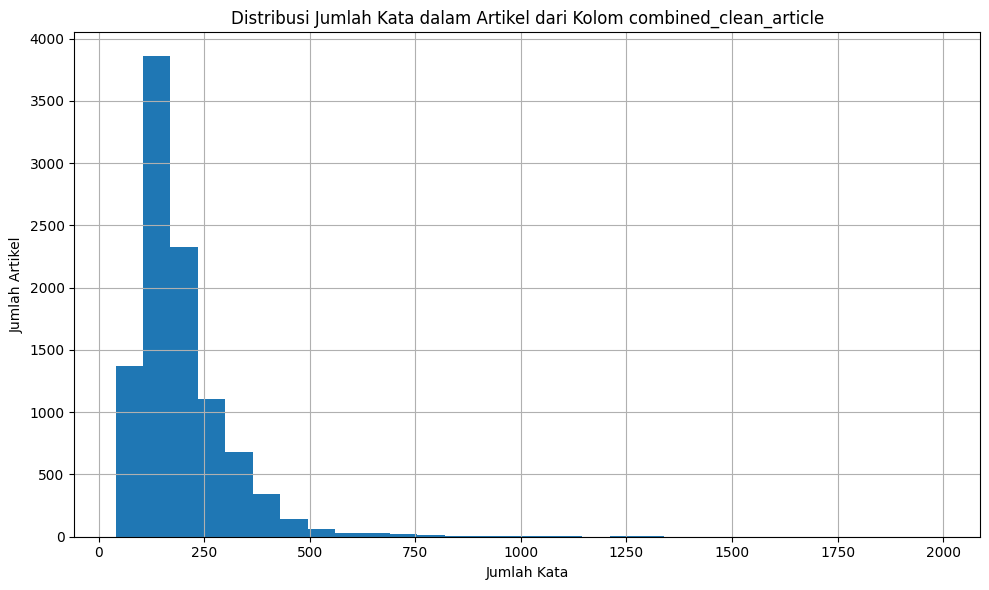

In [ ]:
# Menghitung jumlah kata dalam setiap entri kolom 'combined_clean_article'
train_set['word_count'] = train_set['combined_clean_article'].apply(lambda x: len(x.split()))

# Membuat histogram untuk distribusi panjang kata
plt.figure(figsize=(10, 6))
plt.hist(train_set['word_count'], bins=30)
plt.xlabel('Jumlah Kata')
plt.ylabel('Jumlah Artikel')
plt.title('Distribusi Jumlah Kata dalam Artikel dari Kolom combined_clean_article')
plt.grid(True)
plt.tight_layout()
plt.show()

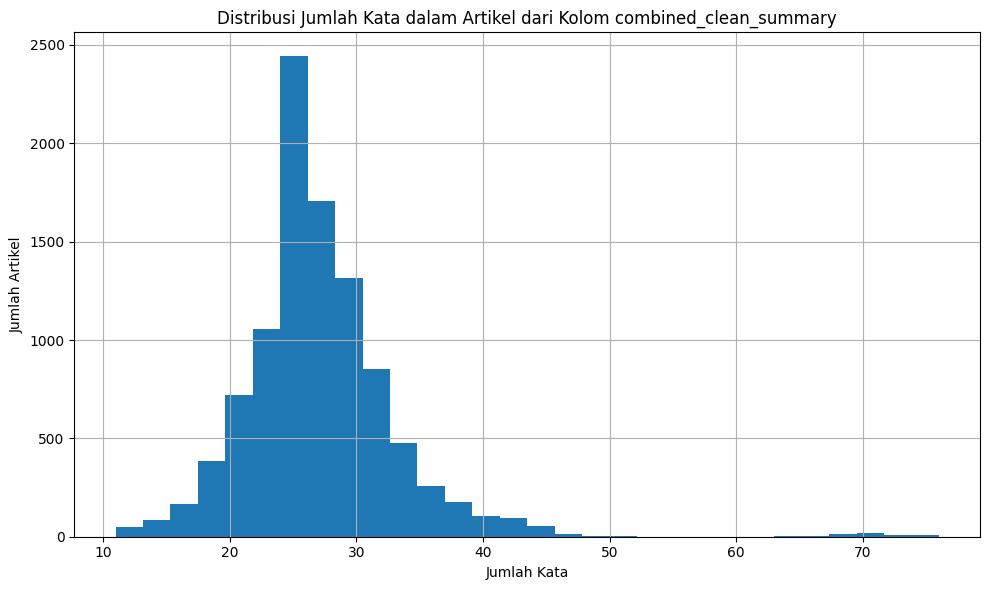

In [ ]:
# Menghitung jumlah kata dalam setiap entri kolom 'combined_clean_article'
train_set['word_count'] = train_set['combined_clean_summary'].apply(lambda x: len(x.split()))

# Membuat histogram untuk distribusi panjang kata
plt.figure(figsize=(10, 6))
plt.hist(train_set['word_count'], bins=30)
plt.xlabel('Jumlah Kata')
plt.ylabel('Jumlah Artikel')
plt.title('Distribusi Jumlah Kata dalam Artikel dari Kolom combined_clean_summary')
plt.grid(True)
plt.tight_layout()
plt.show()

# Get top 10 most common words

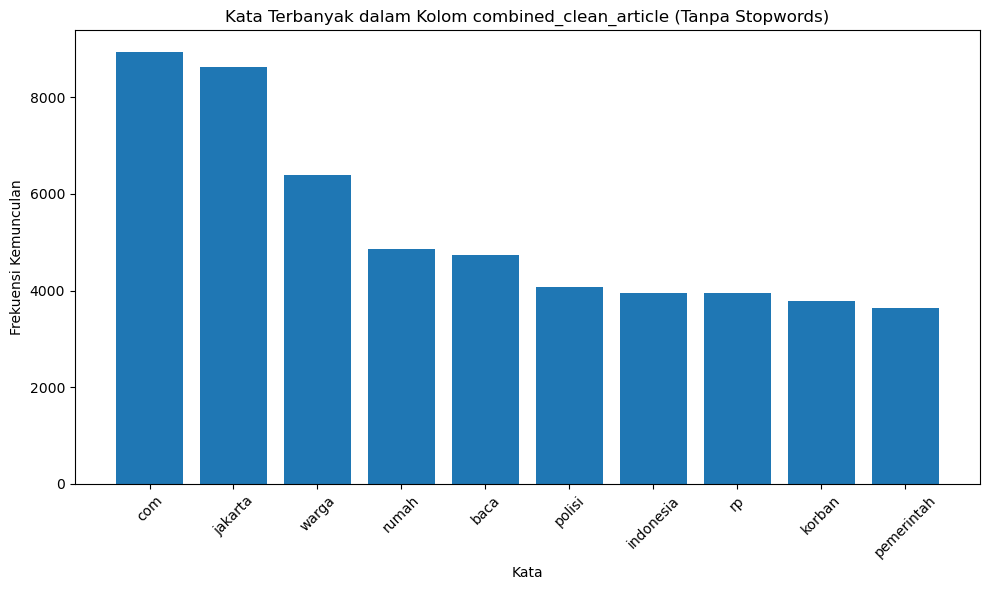

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk

# Load stopwords for Indonesian language
stop_words = set(stopwords.words('indonesian'))

# Function to remove stopwords and non-alphabetic characters from text
def remove_stopwords_and_non_alpha(text):
    return [word.lower() for word in text if word.lower() not in stop_words and word.isalpha()]

# Combine all texts from 'combined_clean_article'
all_texts = ' '.join(train_set['combined_clean_article'])

# Tokenize and remove stopwords from all_texts
filtered_words = remove_stopwords_and_non_alpha(word_tokenize(all_texts))

# Count word frequencies
word_counts = Counter(filtered_words)

# Get top 10 most common words
top_10_words = word_counts.most_common(10)

# Visualize top 10 words using a bar chart
plt.figure(figsize=(10, 6))
words, counts = zip(*top_10_words)
plt.bar(words, counts)
plt.xlabel('Kata')
plt.ylabel('Frekuensi Kemunculan')
plt.title('Kata Terbanyak dalam Kolom combined_clean_article (Tanpa Stopwords)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

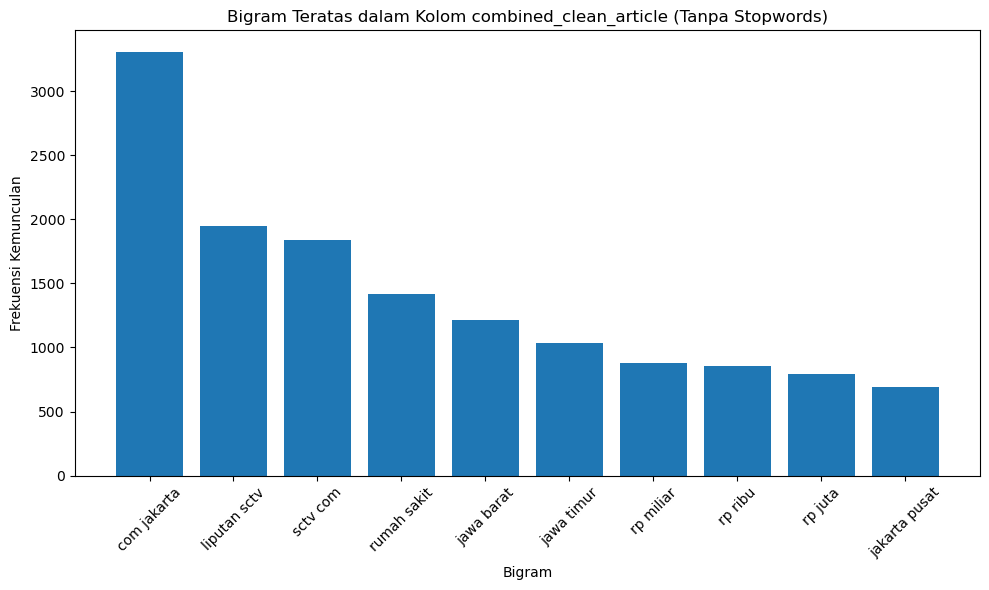

In [ ]:
from nltk import ngrams
# Load stopwords for Indonesian language
stop_words = set(stopwords.words('indonesian'))

# Function to remove stopwords and non-alphabetic characters from text
def remove_stopwords_and_non_alpha(text):
    return [word.lower() for word in text if word.lower() not in stop_words and word.isalpha()]

# Combine all texts from 'combined_clean_article'
all_texts = ' '.join(train_set['combined_clean_article'])

# Tokenize and remove stopwords from all_texts
filtered_words = remove_stopwords_and_non_alpha(word_tokenize(all_texts))

# Generate 2-grams (bigrams)
bigrams = list(ngrams(filtered_words, 2))

# Count bigram frequencies
bigram_counts = Counter(bigrams)

# Get top 10 most common bigrams
top_10_bigrams = bigram_counts.most_common(10)

# Visualize top 10 bigrams using a bar chart
plt.figure(figsize=(10, 6))
bigram_labels = [' '.join(bigram) for bigram, count in top_10_bigrams]
bigram_counts = [count for bigram, count in top_10_bigrams]
plt.bar(bigram_labels, bigram_counts)
plt.xlabel('Bigram')
plt.ylabel('Frekuensi Kemunculan')
plt.title('Bigram Teratas dalam Kolom combined_clean_article (Tanpa Stopwords)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

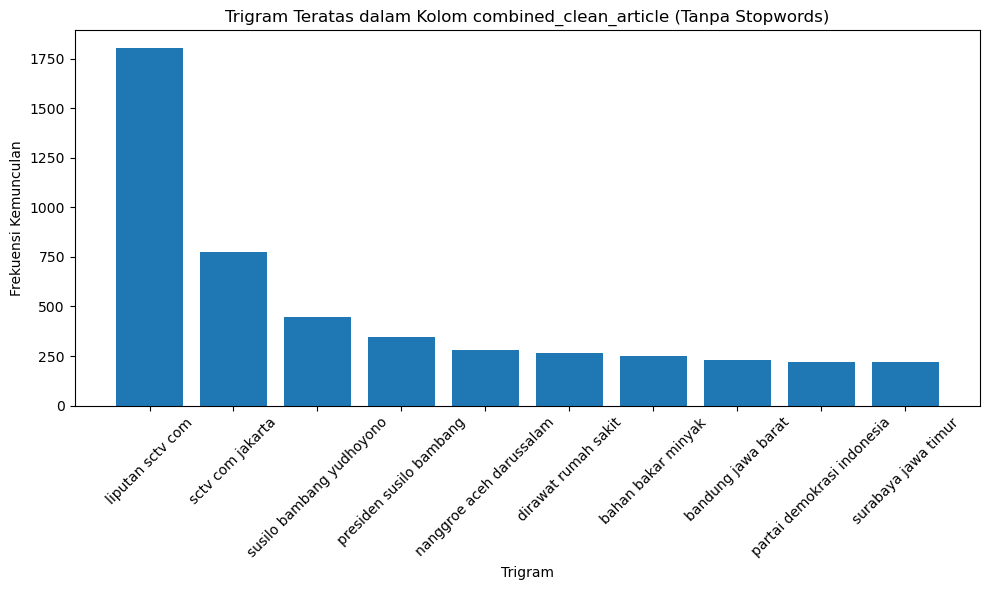

In [ ]:
# Load stopwords for Indonesian language
stop_words = set(stopwords.words('indonesian'))

# Function to remove stopwords and non-alphabetic characters from text
def remove_stopwords_and_non_alpha(text):
    return [word.lower() for word in text if word.lower() not in stop_words and word.isalpha()]

# Combine all texts from 'combined_clean_article'
all_texts = ' '.join(train_set['combined_clean_article'])

# Tokenize and remove stopwords from all_texts
filtered_words = remove_stopwords_and_non_alpha(word_tokenize(all_texts))

# Generate 3-grams (trigrams)
trigrams = list(ngrams(filtered_words, 3))

# Count trigram frequencies
trigram_counts = Counter(trigrams)

# Get top 10 most common trigrams
top_10_trigrams = trigram_counts.most_common(10)

# Visualize top 10 trigrams using a bar chart
plt.figure(figsize=(10, 6))
trigram_labels = [' '.join(trigram) for trigram, count in top_10_trigrams]
trigram_counts = [count for trigram, count in top_10_trigrams]
plt.bar(trigram_labels, trigram_counts)
plt.xlabel('Trigram')
plt.ylabel('Frekuensi Kemunculan')
plt.title('Trigram Teratas dalam Kolom combined_clean_article (Tanpa Stopwords)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## WordCloud

### WordCloud combined_clean_article

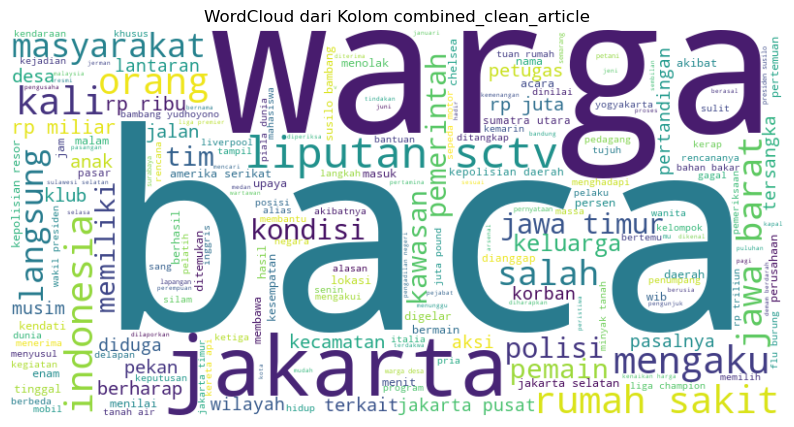

In [ ]:
# Combine all texts from 'combined_clean_article'
all_texts = ' '.join(train_set['combined_clean_article'])

# Load stopwords for Indonesian language
stop_words = set(stopwords.words('indonesian'))

# Function to remove stopwords and non-alphabetic characters from text
def remove_stopwords_and_non_alpha(text):
    return ' '.join([word.lower() for word in word_tokenize(text) if word.lower() not in stop_words and word.isalpha()])

# Apply function to remove stopwords and non-alphabetic characters
processed_text = remove_stopwords_and_non_alpha(all_texts)

# Generate WordCloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(processed_text)

# Display WordCloud using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('WordCloud dari Kolom combined_clean_article')
plt.show()

### WordCloud combined_clean_summary

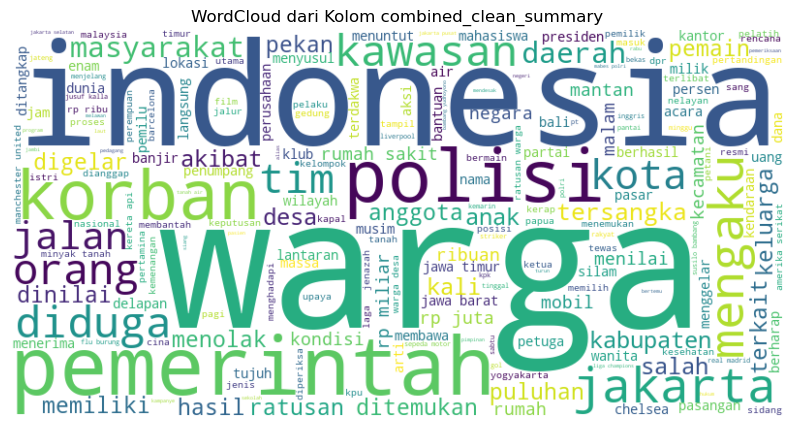

In [ ]:
# Combine all texts from 'combined_clean_article'
all_texts = ' '.join(train_set['combined_clean_summary'])

# Load stopwords for Indonesian language
stop_words = set(stopwords.words('indonesian'))

# Function to remove stopwords and non-alphabetic characters from text
def remove_stopwords_and_non_alpha(text):
    return ' '.join([word.lower() for word in word_tokenize(text) if word.lower() not in stop_words and word.isalpha()])

# Apply function to remove stopwords and non-alphabetic characters
processed_text = remove_stopwords_and_non_alpha(all_texts)

# Generate WordCloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(processed_text)

# Display WordCloud using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('WordCloud dari Kolom combined_clean_summary')
plt.show()

## Text Exploration

In [ ]:
def extract_awal_berita(text):
    match = re.search(r'Liputan6\. com, [A-Za-z\s]+:', text)
    return match.group(0) if match else ''

In [ ]:
train_set['ekstrak_awal_berita'] = train_set['combined_clean_article'].apply(extract_awal_berita)

In [ ]:
train_set

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,ekstrak_awal_berita
0,13019,https://www.liputan6.com/news/read/13019/kapol...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kapolda', 'Riau', 'baru', 'Brigjen', 'Pol',...","[0, 4, 9]","Liputan6. com, Jakarta: Kepolisian Daerah Riau...",Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,"Liputan6. com, Jakarta:"
1,13020,https://www.liputan6.com/news/read/13020/bi-di...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kendati', 'Bank', 'Sentral', 'AS', 'menurun...","[0, 4]","Liputan6. com, Jakarta: Bank Indonesia dinilai...",Kendati Bank Sentral AS menurunkan suku bungan...,"Liputan6. com, Jakarta:"
2,13022,https://www.liputan6.com/news/read/13022/pemer...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Pemerintah', 'bermaksud', 'akan', 'lebih', ...","[0, 7]","Liputan6. com, Jakarta: Berbagai kendala mengh...",Pemerintah bermaksud akan lebih mengandalkan s...,"Liputan6. com, Jakarta:"
3,13024,https://www.liputan6.com/news/read/13024/perub...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Revisi', 'Kepmennaker', 'Nomor', '78', 'Tah...","[0, 8]","Liputan6. com, Jakarta: Penghapusan beberapa p...","Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...","Liputan6. com, Jakarta:"
4,13025,https://www.liputan6.com/news/read/13025/puluh...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Polisi', 'menangkap', '32', 'pengunjung', '...","[2, 3]","Liputan6. com, Jakarta: Operasi Sadar Jaya yan...",Polisi menangkap 32 pengunjung Diskotik Mileni...,"Liputan6. com, Jakarta:"
...,...,...,...,...,...,...,...,...
10967,26400,https://www.liputan6.com/news/read/26400/kasus...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kejagung', 'masih', 'menunggu', 'putusan', ...","[0, 3]","Liputan6. com, Jakarta: Kejaksaan Agung, hingg...",Kejagung masih menunggu putusan hakim PN Jakse...,"Liputan6. com, Jakarta:"
10968,26401,https://www.liputan6.com/news/read/26401/mator...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Ketua', 'DPP', 'PKB', 'Khofifah', 'Indarpar...","[0, 2]","Liputan6. com, Jakarta: Dewan Pimpinan Pusat P...",Ketua DPP PKB Khofifah Indarparawansa menuduh ...,"Liputan6. com, Jakarta:"
10969,26402,https://www.liputan6.com/news/read/26402/warga...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Menyambut', 'Tahun', 'Baru', '2002', ',', '...","[0, 6]","Liputan6. com, Jakarta: Warga Kampung Melayu, ...","Menyambut Tahun Baru 2002, warga Kampung Melay...","Liputan6. com, Jakarta:"
10970,26403,https://www.liputan6.com/news/read/26403/penja...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Romadhani', 'alias', 'Roban', 'tewas', 'dit...","[0, 5]","Liputan6. com, Jakarta: Romadhani alias Roban,...",Romadhani alias Roban tewas ditembak polisi sa...,"Liputan6. com, Jakarta:"


In [ ]:
def extract_hari_tanggal(text):
    match = re.search(r'\w+\s*\(\d{1,2}/\d{1,2}\)', text)
    return match.group(0) if match else ''

In [ ]:
train_set['ekstrak_hari_tanggal'] = train_set['combined_clean_article'].apply(extract_hari_tanggal)

In [ ]:
train_set

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal
0,13019,https://www.liputan6.com/news/read/13019/kapol...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kapolda', 'Riau', 'baru', 'Brigjen', 'Pol',...","[0, 4, 9]","Liputan6. com, Jakarta: Kepolisian Daerah Riau...",Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,"Liputan6. com, Jakarta:",
1,13020,https://www.liputan6.com/news/read/13020/bi-di...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kendati', 'Bank', 'Sentral', 'AS', 'menurun...","[0, 4]","Liputan6. com, Jakarta: Bank Indonesia dinilai...",Kendati Bank Sentral AS menurunkan suku bungan...,"Liputan6. com, Jakarta:",
2,13022,https://www.liputan6.com/news/read/13022/pemer...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Pemerintah', 'bermaksud', 'akan', 'lebih', ...","[0, 7]","Liputan6. com, Jakarta: Berbagai kendala mengh...",Pemerintah bermaksud akan lebih mengandalkan s...,"Liputan6. com, Jakarta:",
3,13024,https://www.liputan6.com/news/read/13024/perub...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Revisi', 'Kepmennaker', 'Nomor', '78', 'Tah...","[0, 8]","Liputan6. com, Jakarta: Penghapusan beberapa p...","Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...","Liputan6. com, Jakarta:",
4,13025,https://www.liputan6.com/news/read/13025/puluh...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Polisi', 'menangkap', '32', 'pengunjung', '...","[2, 3]","Liputan6. com, Jakarta: Operasi Sadar Jaya yan...",Polisi menangkap 32 pengunjung Diskotik Mileni...,"Liputan6. com, Jakarta:",Selasa (15/5)
...,...,...,...,...,...,...,...,...,...
10967,26400,https://www.liputan6.com/news/read/26400/kasus...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kejagung', 'masih', 'menunggu', 'putusan', ...","[0, 3]","Liputan6. com, Jakarta: Kejaksaan Agung, hingg...",Kejagung masih menunggu putusan hakim PN Jakse...,"Liputan6. com, Jakarta:",
10968,26401,https://www.liputan6.com/news/read/26401/mator...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Ketua', 'DPP', 'PKB', 'Khofifah', 'Indarpar...","[0, 2]","Liputan6. com, Jakarta: Dewan Pimpinan Pusat P...",Ketua DPP PKB Khofifah Indarparawansa menuduh ...,"Liputan6. com, Jakarta:",Senin (31/12)
10969,26402,https://www.liputan6.com/news/read/26402/warga...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Menyambut', 'Tahun', 'Baru', '2002', ',', '...","[0, 6]","Liputan6. com, Jakarta: Warga Kampung Melayu, ...","Menyambut Tahun Baru 2002, warga Kampung Melay...","Liputan6. com, Jakarta:",
10970,26403,https://www.liputan6.com/news/read/26403/penja...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Romadhani', 'alias', 'Roban', 'tewas', 'dit...","[0, 5]","Liputan6. com, Jakarta: Romadhani alias Roban,...",Romadhani alias Roban tewas ditembak polisi sa...,"Liputan6. com, Jakarta:",Senin (31/12)


In [ ]:
def extract_nama_penulis(text):
    match = re.search(r'\([A-Z]+/[A-Za-z\s]+(?: dan [A-Za-z\s]+)?\)\.', text)
    return match.group(0) if match else ''

In [ ]:
train_set['ekstrak_nama_penulis'] = train_set['combined_clean_article'].apply(extract_nama_penulis)

In [ ]:
train_set

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal,ekstrak_nama_penulis
0,13019,https://www.liputan6.com/news/read/13019/kapol...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kapolda', 'Riau', 'baru', 'Brigjen', 'Pol',...","[0, 4, 9]","Liputan6. com, Jakarta: Kepolisian Daerah Riau...",Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,"Liputan6. com, Jakarta:",,(ICH/Edi Priyono dan Andi Azril).
1,13020,https://www.liputan6.com/news/read/13020/bi-di...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kendati', 'Bank', 'Sentral', 'AS', 'menurun...","[0, 4]","Liputan6. com, Jakarta: Bank Indonesia dinilai...",Kendati Bank Sentral AS menurunkan suku bungan...,"Liputan6. com, Jakarta:",,(ICH/Fahmi Ihsan dan Donny Indradi).
2,13022,https://www.liputan6.com/news/read/13022/pemer...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Pemerintah', 'bermaksud', 'akan', 'lebih', ...","[0, 7]","Liputan6. com, Jakarta: Berbagai kendala mengh...",Pemerintah bermaksud akan lebih mengandalkan s...,"Liputan6. com, Jakarta:",,(COK/Olivia Rosalia dan Donni Indradi).
3,13024,https://www.liputan6.com/news/read/13024/perub...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Revisi', 'Kepmennaker', 'Nomor', '78', 'Tah...","[0, 8]","Liputan6. com, Jakarta: Penghapusan beberapa p...","Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...","Liputan6. com, Jakarta:",,(ICH/Tris Wijayanto dan Agus Ginanjar).
4,13025,https://www.liputan6.com/news/read/13025/puluh...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Polisi', 'menangkap', '32', 'pengunjung', '...","[2, 3]","Liputan6. com, Jakarta: Operasi Sadar Jaya yan...",Polisi menangkap 32 pengunjung Diskotik Mileni...,"Liputan6. com, Jakarta:",Selasa (15/5),(COK/Christiyanto dan Johni Akbar).
...,...,...,...,...,...,...,...,...,...,...
10967,26400,https://www.liputan6.com/news/read/26400/kasus...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kejagung', 'masih', 'menunggu', 'putusan', ...","[0, 3]","Liputan6. com, Jakarta: Kejaksaan Agung, hingg...",Kejagung masih menunggu putusan hakim PN Jakse...,"Liputan6. com, Jakarta:",,(PIN/Apriliana dan Prihandoyo).
10968,26401,https://www.liputan6.com/news/read/26401/mator...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Ketua', 'DPP', 'PKB', 'Khofifah', 'Indarpar...","[0, 2]","Liputan6. com, Jakarta: Dewan Pimpinan Pusat P...",Ketua DPP PKB Khofifah Indarparawansa menuduh ...,"Liputan6. com, Jakarta:",Senin (31/12),(ICH/Edi Priyono dan Binsar Rahardian).
10969,26402,https://www.liputan6.com/news/read/26402/warga...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Menyambut', 'Tahun', 'Baru', '2002', ',', '...","[0, 6]","Liputan6. com, Jakarta: Warga Kampung Melayu, ...","Menyambut Tahun Baru 2002, warga Kampung Melay...","Liputan6. com, Jakarta:",,(AWD/Nurul Amin dan Gatot Setiawan).
10970,26403,https://www.liputan6.com/news/read/26403/penja...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Romadhani', 'alias', 'Roban', 'tewas', 'dit...","[0, 5]","Liputan6. com, Jakarta: Romadhani alias Roban,...",Romadhani alias Roban tewas ditembak polisi sa...,"Liputan6. com, Jakarta:",Senin (31/12),(ZAQ/Nurul Amin dan Gatot Setiawan).


In [ ]:
def extract_baca(text):
    match = re.search(r'\[baca: .*?\]', text)
    return match.group(0) if match else ''

In [ ]:
train_set['ekstrak_baca'] = train_set['combined_clean_article'].apply(extract_baca)

In [ ]:
train_set

,id,url,clean_article,clean_summary,extractive_summary,combined_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal,ekstrak_nama_penulis,ekstrak_baca
0,13019,https://www.liputan6.com/news/read/13019/kapol...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kapolda', 'Riau', 'baru', 'Brigjen', 'Pol',...","[0, 4, 9]","Liputan6. com, Jakarta: Kepolisian Daerah Riau...",Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,"Liputan6. com, Jakarta:",,(ICH/Edi Priyono dan Andi Azril).,
1,13020,https://www.liputan6.com/news/read/13020/bi-di...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kendati', 'Bank', 'Sentral', 'AS', 'menurun...","[0, 4]","Liputan6. com, Jakarta: Bank Indonesia dinilai...",Kendati Bank Sentral AS menurunkan suku bungan...,"Liputan6. com, Jakarta:",,(ICH/Fahmi Ihsan dan Donny Indradi).,
2,13022,https://www.liputan6.com/news/read/13022/pemer...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Pemerintah', 'bermaksud', 'akan', 'lebih', ...","[0, 7]","Liputan6. com, Jakarta: Berbagai kendala mengh...",Pemerintah bermaksud akan lebih mengandalkan s...,"Liputan6. com, Jakarta:",,(COK/Olivia Rosalia dan Donni Indradi).,
3,13024,https://www.liputan6.com/news/read/13024/perub...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Revisi', 'Kepmennaker', 'Nomor', '78', 'Tah...","[0, 8]","Liputan6. com, Jakarta: Penghapusan beberapa p...","Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...","Liputan6. com, Jakarta:",,(ICH/Tris Wijayanto dan Agus Ginanjar).,[baca: Pemerintah Didesak Mencabut Kepmennaker...
4,13025,https://www.liputan6.com/news/read/13025/puluh...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Polisi', 'menangkap', '32', 'pengunjung', '...","[2, 3]","Liputan6. com, Jakarta: Operasi Sadar Jaya yan...",Polisi menangkap 32 pengunjung Diskotik Mileni...,"Liputan6. com, Jakarta:",Selasa (15/5),(COK/Christiyanto dan Johni Akbar).,
...,...,...,...,...,...,...,...,...,...,...,...
10967,26400,https://www.liputan6.com/news/read/26400/kasus...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Kejagung', 'masih', 'menunggu', 'putusan', ...","[0, 3]","Liputan6. com, Jakarta: Kejaksaan Agung, hingg...",Kejagung masih menunggu putusan hakim PN Jakse...,"Liputan6. com, Jakarta:",,(PIN/Apriliana dan Prihandoyo).,[baca: Kejagung Meminta Berkas Kasus Soeharto ...
10968,26401,https://www.liputan6.com/news/read/26401/mator...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Ketua', 'DPP', 'PKB', 'Khofifah', 'Indarpar...","[0, 2]","Liputan6. com, Jakarta: Dewan Pimpinan Pusat P...",Ketua DPP PKB Khofifah Indarparawansa menuduh ...,"Liputan6. com, Jakarta:",Senin (31/12),(ICH/Edi Priyono dan Binsar Rahardian).,
10969,26402,https://www.liputan6.com/news/read/26402/warga...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Menyambut', 'Tahun', 'Baru', '2002', ',', '...","[0, 6]","Liputan6. com, Jakarta: Warga Kampung Melayu, ...","Menyambut Tahun Baru 2002, warga Kampung Melay...","Liputan6. com, Jakarta:",,(AWD/Nurul Amin dan Gatot Setiawan).,
10970,26403,https://www.liputan6.com/news/read/26403/penja...,"[['Liputan6', '.', 'com', ',', 'Jakarta', ':',...","[['Romadhani', 'alias', 'Roban', 'tewas', 'dit...","[0, 5]","Liputan6. com, Jakarta: Romadhani alias Roban,...",Romadhani alias Roban tewas ditembak polisi sa...,"Liputan6. com, Jakarta:",Senin (31/12),(ZAQ/Nurul Amin dan Gatot Setiawan).,


## Preprocessing

In [ ]:
def clean_article(text):
    text = re.sub(r'Liputan6\. com, [A-Za-z\s]+:', '', text)
    text = re.sub(r'\w+\s*\(\d{1,2}/\d{1,2}\)', '', text)
    text = re.sub(r'\([A-Z]+/[A-Za-z\s]+(?: dan [A-Za-z\s]+)?\)\.', '', text)
    text = re.sub(r'\[baca: .*?\]', '', text)
    return text.strip()

In [ ]:
train_set['final_clean_article'] = train_set['combined_clean_article'].apply(clean_article)
valid_set['final_clean_article'] = valid_set['combined_clean_article'].apply(clean_article)
test_set['final_clean_article'] = test_set['combined_clean_article'].apply(clean_article)

In [ ]:
final_train_set = train_set[['final_clean_article','combined_clean_summary']]
final_valid_set = valid_set[['final_clean_article','combined_clean_summary']]
final_test_set = test_set[['final_clean_article','combined_clean_summary']]

## Sanity Check

In [ ]:
def extract_awal_berita(text):
    match = re.search(r'Liputan6\. com, [A-Za-z\s]+:', text)
    return match.group(0) if match else ''

In [ ]:
final_train_set['ekstrak_awal_berita'] = final_train_set['final_clean_article'].apply(extract_awal_berita)

In [ ]:
final_train_set

,final_clean_article,combined_clean_summary,ekstrak_awal_berita
0,Kepolisian Daerah Riau bertekad memberantas pe...,Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,
1,Bank Indonesia dinilai masih akan menghadapi s...,Kendati Bank Sentral AS menurunkan suku bungan...,
2,Berbagai kendala menghambat pendapatan negara ...,Pemerintah bermaksud akan lebih mengandalkan s...,
3,Penghapusan beberapa pasal menyangkut hak buru...,"Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...",
4,"Operasi Sadar Jaya yang dilancarkan malam, se...",Polisi menangkap 32 pengunjung Diskotik Mileni...,
...,...,...,...
10967,"Kejaksaan Agung, hingga kini, masih menunggu p...",Kejagung masih menunggu putusan hakim PN Jakse...,
10968,Dewan Pimpinan Pusat Partai Kebangkitan Bangsa...,Ketua DPP PKB Khofifah Indarparawansa menuduh ...,
10969,"Warga Kampung Melayu, Jakarta Timur, menggelar...","Menyambut Tahun Baru 2002, warga Kampung Melay...",
10970,"Romadhani alias Roban, penjahat kelas kakap, t...",Romadhani alias Roban tewas ditembak polisi sa...,


In [ ]:
train_set_with_awal_berita = final_train_set.loc[final_train_set['ekstrak_awal_berita'] != '']
train_set_with_awal_berita

,final_clean_article,combined_clean_summary,ekstrak_awal_berita


In [ ]:
def extract_hari_tanggal(text):
    match = re.search(r'\w+\s*\(\d{1,2}/\d{1,2}\)', text)
    return match.group(0) if match else ''

In [ ]:
final_train_set['ekstrak_hari_tanggal'] = final_train_set['final_clean_article'].apply(extract_hari_tanggal)

In [ ]:
final_train_set

,final_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal
0,Kepolisian Daerah Riau bertekad memberantas pe...,Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,,
1,Bank Indonesia dinilai masih akan menghadapi s...,Kendati Bank Sentral AS menurunkan suku bungan...,,
2,Berbagai kendala menghambat pendapatan negara ...,Pemerintah bermaksud akan lebih mengandalkan s...,,
3,Penghapusan beberapa pasal menyangkut hak buru...,"Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...",,
4,"Operasi Sadar Jaya yang dilancarkan malam, se...",Polisi menangkap 32 pengunjung Diskotik Mileni...,,
...,...,...,...,...
10967,"Kejaksaan Agung, hingga kini, masih menunggu p...",Kejagung masih menunggu putusan hakim PN Jakse...,,
10968,Dewan Pimpinan Pusat Partai Kebangkitan Bangsa...,Ketua DPP PKB Khofifah Indarparawansa menuduh ...,,
10969,"Warga Kampung Melayu, Jakarta Timur, menggelar...","Menyambut Tahun Baru 2002, warga Kampung Melay...",,
10970,"Romadhani alias Roban, penjahat kelas kakap, t...",Romadhani alias Roban tewas ditembak polisi sa...,,


In [ ]:
train_set_with_hari_tanggal = final_train_set.loc[final_train_set['ekstrak_hari_tanggal'] != '']
train_set_with_hari_tanggal

,final_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal


In [ ]:
def extract_nama_penulis(text):
    match = re.search(r'\([A-Z]+/[A-Za-z\s]+(?: dan [A-Za-z\s]+)?\)\.', text)
    return match.group(0) if match else ''

In [ ]:
final_train_set['ekstrak_nama_penulis'] = final_train_set['final_clean_article'].apply(extract_nama_penulis)

In [ ]:
final_train_set

,final_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal,ekstrak_nama_penulis
0,Kepolisian Daerah Riau bertekad memberantas pe...,Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,,,
1,Bank Indonesia dinilai masih akan menghadapi s...,Kendati Bank Sentral AS menurunkan suku bungan...,,,
2,Berbagai kendala menghambat pendapatan negara ...,Pemerintah bermaksud akan lebih mengandalkan s...,,,
3,Penghapusan beberapa pasal menyangkut hak buru...,"Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...",,,
4,"Operasi Sadar Jaya yang dilancarkan malam, se...",Polisi menangkap 32 pengunjung Diskotik Mileni...,,,
...,...,...,...,...,...
10967,"Kejaksaan Agung, hingga kini, masih menunggu p...",Kejagung masih menunggu putusan hakim PN Jakse...,,,
10968,Dewan Pimpinan Pusat Partai Kebangkitan Bangsa...,Ketua DPP PKB Khofifah Indarparawansa menuduh ...,,,
10969,"Warga Kampung Melayu, Jakarta Timur, menggelar...","Menyambut Tahun Baru 2002, warga Kampung Melay...",,,
10970,"Romadhani alias Roban, penjahat kelas kakap, t...",Romadhani alias Roban tewas ditembak polisi sa...,,,


In [ ]:
train_set_with_nama_penulis = final_train_set.loc[final_train_set['ekstrak_nama_penulis'] != '']
train_set_with_nama_penulis

,final_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal,ekstrak_nama_penulis


In [ ]:
def extract_baca(text):
    match = re.search(r'\[baca: .*?\]', text)
    return match.group(0) if match else ''

In [ ]:
final_train_set['ekstrak_baca'] = final_train_set['final_clean_article'].apply(extract_baca)

In [ ]:
final_train_set

,final_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal,ekstrak_nama_penulis,ekstrak_baca
0,Kepolisian Daerah Riau bertekad memberantas pe...,Kapolda Riau baru Brigjen Pol. Johny Yodjana b...,,,,
1,Bank Indonesia dinilai masih akan menghadapi s...,Kendati Bank Sentral AS menurunkan suku bungan...,,,,
2,Berbagai kendala menghambat pendapatan negara ...,Pemerintah bermaksud akan lebih mengandalkan s...,,,,
3,Penghapusan beberapa pasal menyangkut hak buru...,"Revisi Kepmennaker Nomor 78 Tahun 2001, dinila...",,,,
4,"Operasi Sadar Jaya yang dilancarkan malam, se...",Polisi menangkap 32 pengunjung Diskotik Mileni...,,,,
...,...,...,...,...,...,...
10967,"Kejaksaan Agung, hingga kini, masih menunggu p...",Kejagung masih menunggu putusan hakim PN Jakse...,,,,
10968,Dewan Pimpinan Pusat Partai Kebangkitan Bangsa...,Ketua DPP PKB Khofifah Indarparawansa menuduh ...,,,,
10969,"Warga Kampung Melayu, Jakarta Timur, menggelar...","Menyambut Tahun Baru 2002, warga Kampung Melay...",,,,
10970,"Romadhani alias Roban, penjahat kelas kakap, t...",Romadhani alias Roban tewas ditembak polisi sa...,,,,


In [ ]:
train_set_with_baca = final_train_set.loc[final_train_set['ekstrak_baca'] != '']
train_set_with_baca

,final_clean_article,combined_clean_summary,ekstrak_awal_berita,ekstrak_hari_tanggal,ekstrak_nama_penulis,ekstrak_baca


In [ ]:
final_train_set = final_train_set[['final_clean_article','combined_clean_summary']]
final_valid_set = final_valid_set[['final_clean_article','combined_clean_summary']]
final_test_set = final_test_set[['final_clean_article','combined_clean_summary']]

In [ ]:
final_train_set

,final_clean_article,combined_clean_summary
0,Kepolisian Daerah Riau bertekad memberantas pe...,Kapolda Riau baru Brigjen Pol. Johny Yodjana b...
1,Bank Indonesia dinilai masih akan menghadapi s...,Kendati Bank Sentral AS menurunkan suku bungan...
2,Berbagai kendala menghambat pendapatan negara ...,Pemerintah bermaksud akan lebih mengandalkan s...
3,Penghapusan beberapa pasal menyangkut hak buru...,"Revisi Kepmennaker Nomor 78 Tahun 2001, dinila..."
4,"Operasi Sadar Jaya yang dilancarkan malam, se...",Polisi menangkap 32 pengunjung Diskotik Mileni...
...,...,...
10967,"Kejaksaan Agung, hingga kini, masih menunggu p...",Kejagung masih menunggu putusan hakim PN Jakse...
10968,Dewan Pimpinan Pusat Partai Kebangkitan Bangsa...,Ketua DPP PKB Khofifah Indarparawansa menuduh ...
10969,"Warga Kampung Melayu, Jakarta Timur, menggelar...","Menyambut Tahun Baru 2002, warga Kampung Melay..."
10970,"Romadhani alias Roban, penjahat kelas kakap, t...",Romadhani alias Roban tewas ditembak polisi sa...


In [ ]:
final_valid_set

,final_clean_article,combined_clean_summary
0,Kolonel Richard Ginting dinonaktifkan dari jab...,Kolonel Richard Ginting dinyatakan terlibat bi...
1,Acong ditangkap polisi karena mendalangi pencu...,Acong dipergoki rekan sesama satpam membawa ka...
2,Presiden Susilo Bambang Yudhoyono menggelar ja...,Jamuan makan malam bagi peserta KAA diadakan d...
3,Lebih dari seratus pengikut aliran Falun Gong ...,Mereka berdemonstrasi di saat para delegasi me...
4,Mantan Deputi Kepala Badan Penyehatan Perbanka...,"TMM, mantan Deputi Kepala Badan Penyehatan Per..."
...,...,...
9995,Presiden Susilo Bambang Yudhoyono telah meneke...,Presiden Susilo Bambang Yudhoyono telah menand...
9996,Sejumlah mahasiswa asal Maluku menggelar unjuk...,Sejumlah mahasiswa dari Aliansi Gerakan Peduli...
9997,"Dua kelompok massa, Front Perjuangan Pemuda In...",Massa Front Perjuangan Pemuda Indonesia (FPPI)...
9998,Wanita identik dengan keindahan dan kelembutan...,Sebanyak delapan pelukis wanita ikut serta dal...


In [ ]:
final_test_set

,final_clean_article,combined_clean_summary
0,Kepolisian Daerah Riau bertekad memberantas pe...,Kapolda Riau baru Brigjen Pol. Johny Yodjana b...
1,Bank Indonesia dinilai masih akan menghadapi s...,Kendati Bank Sentral AS menurunkan suku bungan...
2,Berbagai kendala menghambat pendapatan negara ...,Pemerintah bermaksud akan lebih mengandalkan s...
3,Penghapusan beberapa pasal menyangkut hak buru...,"Revisi Kepmennaker Nomor 78 Tahun 2001, dinila..."
4,"Operasi Sadar Jaya yang dilancarkan malam, se...",Polisi menangkap 32 pengunjung Diskotik Mileni...
...,...,...
10967,"Kejaksaan Agung, hingga kini, masih menunggu p...",Kejagung masih menunggu putusan hakim PN Jakse...
10968,Dewan Pimpinan Pusat Partai Kebangkitan Bangsa...,Ketua DPP PKB Khofifah Indarparawansa menuduh ...
10969,"Warga Kampung Melayu, Jakarta Timur, menggelar...","Menyambut Tahun Baru 2002, warga Kampung Melay..."
10970,"Romadhani alias Roban, penjahat kelas kakap, t...",Romadhani alias Roban tewas ditembak polisi sa...


## Save Data

In [ ]:
final_test_set.to_csv('clean_data/final_test_set.csv', index=False)
final_valid_set.to_csv('clean_data/final_valid_set.csv', index=False)
final_train_set.to_csv('clean_data/final_train_set.csv', index=False)